In [110]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import pytesseract
from pytesseract import Output
import pprint
from skimage.filters import threshold_local
plt.rcParams["figure.figsize"] = (20,20)

1. Simple augmentation. Kaggle image generator. Make sure the labels correspond to them
2. EAST model
3. Maybe even gan later on

Make simple model + test with receipts

In [2]:
def adjust_gamma(image, gamma=1.0):
    # build a lookup table mapping the pixel values [0, 255] to
    # their adjusted gamma values
    invGamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** invGamma) * 255
        for i in np.arange(0, 256)]).astype("uint8")
    # apply gamma correction using the lookup table
    return cv2.LUT(image, table)
def get_grayscale(image):
    return cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# noise removal
def remove_noise(image):
    return cv2.medianBlur(image,5)
 
#thresholding
def thresholding(image):
    return cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]

#dilation
def dilate(image, size=3):
    kernel = np.ones((size,size),np.uint8)
    return cv2.dilate(image, kernel, iterations = 1)
    
#erosion
def erode(image, size=3):
    kernel = np.ones((size,size),np.uint8)
    return cv2.erode(image, kernel, iterations = 1)

#opening - erosion followed by dilation
def opening(image, size=3):
    kernel = np.ones((size,size),np.uint8)
    return cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

#canny edge detection
def canny(image):
    return cv2.Canny(image, 100, 200)

#skew correction
def deskew(image):
    coords = np.column_stack(np.where(image > 0))
    angle = cv2.minAreaRect(coords)[-1]
    if angle < -45:
        angle = -(90 + angle)
    else:
        angle = -angle
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(image, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return rotated

#template matching
def match_template(image, template):
    return cv2.matchTemplate(image, template, cv2.TM_CCOEFF_NORMED) 
def bw_scanner(image):
    T = threshold_local(image, 21, offset = 5, method = "gaussian")
    return (image > T).astype("uint8") * 255

In [3]:
def get_img_of_interest(img_of_interest):
    d = pytesseract.image_to_data(img_of_interest, output_type=Output.DICT)
    n_boxes = len(d['level'])
    for i in range(n_boxes):
        (x, y, w, h) = (d['left'][i], d['top'][i], d['width'][i], d['height'][i])    
        img_of_interest = cv2.rectangle(img_of_interest, (x, y), (x + w, y + h), (0, 0, 255), 2)

    plt.imshow(img_of_interest, 'gray')
    plt.show()

In [4]:
def simple_test_with_img(img):
    fig, axs = plt.subplots(6, 1, figsize=(100, 100))
    gamma_img = adjust_gamma(img, .3)
    thresh = thresholding(gamma_img)
    opened = opening(gamma_img, 1)
    cannied = canny(opened)
    median_blur = remove_noise(img)

    axs[0].imshow(img, 'gray')
    axs[0].set_title('original')
    axs[1].imshow(gamma_img, 'gray')
    axs[1].set_title('gamma image')
    axs[2].imshow(thresh, 'gray')
    axs[2].set_title('threshold image')
    axs[3].imshow(opened, 'gray')
    axs[3].set_title('opened image')
    axs[4].imshow(cannied, 'gray')
    axs[4].set_title('cannied image')
    axs[5].imshow(gamma_img, 'gray')
    axs[5].set_title('median blur image')
    plt.show()

In [5]:
def simple_test(img):
    img = cv2.imread(img,0)
    simple_test_with_img(img)

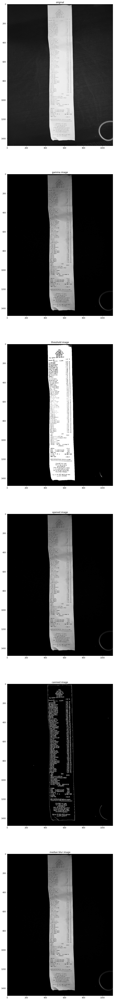

In [6]:
simple_test('sample_receipts/1958.jpg')

In [7]:
def get_img_and_bg_img(img_path):
    img = cv2.imread(img_path,0)
    dilated_img = cv2.dilate(img, np.ones((5,5), np.uint8)) 
    bg_img = cv2.medianBlur(dilated_img, 21)
    return img, bg_img

In [8]:
def detect_texts_simple_with_bg_img_and_img(img, bg_img):
    fig, axs = plt.subplots(5, 1, figsize=(100, 100))
    diff_img = 255 - cv2.absdiff(img, bg_img)
    norm_img = diff_img.copy() 
    cv2.normalize(diff_img, norm_img, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
    _, thr_img = cv2.threshold(adjust_gamma(norm_img, .8), 220, 0, cv2.THRESH_TRUNC)
    cv2.normalize(thr_img, thr_img, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8UC1)
    axs[0].imshow(img, 'gray')
    axs[0].set_title('original')
    
    axs[1].imshow(bg_img, 'gray')
    axs[1].set_title('background image')
    
    axs[2].imshow(diff_img, 'gray')
    axs[2].set_title('diff image')
    
    axs[3].imshow(norm_img, 'gray')
    axs[3].set_title('norm image')
    
    # _, thr_img = cv2.threshold(norm_img,0,230,cv2.THRESH_BINARY)
    # thr_img = cv2.adaptiveThreshold(norm_img,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
    #             cv2.THRESH_BINARY,61,2)
    
    axs[4].imshow(thr_img, 'gray')
    axs[4].set_title('threshold normalized image')
    plt.show()
    extracted_text = pytesseract.image_to_string(adjust_gamma(thr_img.copy(), .4))
    print(extracted_text)
    get_img_of_interest(adjust_gamma(thr_img.copy(), .3))

In [9]:
def detect_texts_simple(img):
    img, bg_img = get_img_and_bg_img(img)
    detect_texts_simple_with_bg_img_and_img(img, bg_img)

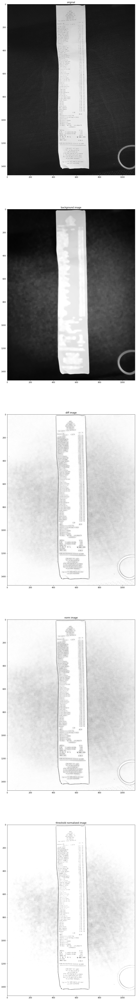

 

NOL
store #4
447) WARKET SE
PHILADELPHIA, PA
gid 400-5054
toi ALD
Your cashier today was Haran )

Beats My, awa

  

sky

oe
aplcycacle 4802
Tralvan 8604 fer
era ORCA

 

   
  
  
  
  
 
 
 
   
 
 
  
 
 
 
 
 
  
 
 
 
 
 
 
 
  
 
 
 
 
 
 
 
 
  
 
 
 
 
 
 
 
  
 
 
 
 
   
   
  

 

  

10s
ule

ere or fatim a
verpned DBtry TOP ae
vom Tce Crete 8
sen) -Sieet Horsels Ye
Shredied Hor ve
Le Te

A aint

ey eae Gms va
Aeon tk Ve
WC 0. No Pulp
J ide Far treat, rd V2
4] capri Sun Pouches 5
Penne or tint on
eren Poorer 3

A tricn Pavcer
ennercnrn Grinder
| Perve
Grape Jey
af Cannes voshreons
Fou! Pan wild
dasa Rice
tut Green Beans
Splst Top tnt Bra
SbIit Te im rd
Rice >
Bice mn
Sliced Carrots
q) Comes tushrears
Gaelic Foucer
Large Ess
Large Eos
Sa Wixed Yenetavies

 

 

Minced Gare
Priano Pasta Sauce
Priana Pasta Sauce
Green Peaoers

Taco Mix

Taco Hix

Taco Mix

Green Onions

fara Tomatoes,

ERBRRRRGRRRSREORR ARRAS RRA Ree

0.89

Hsbeteantedi4 5227 Plt

02/21/21 14:03 Ret /Seq # 

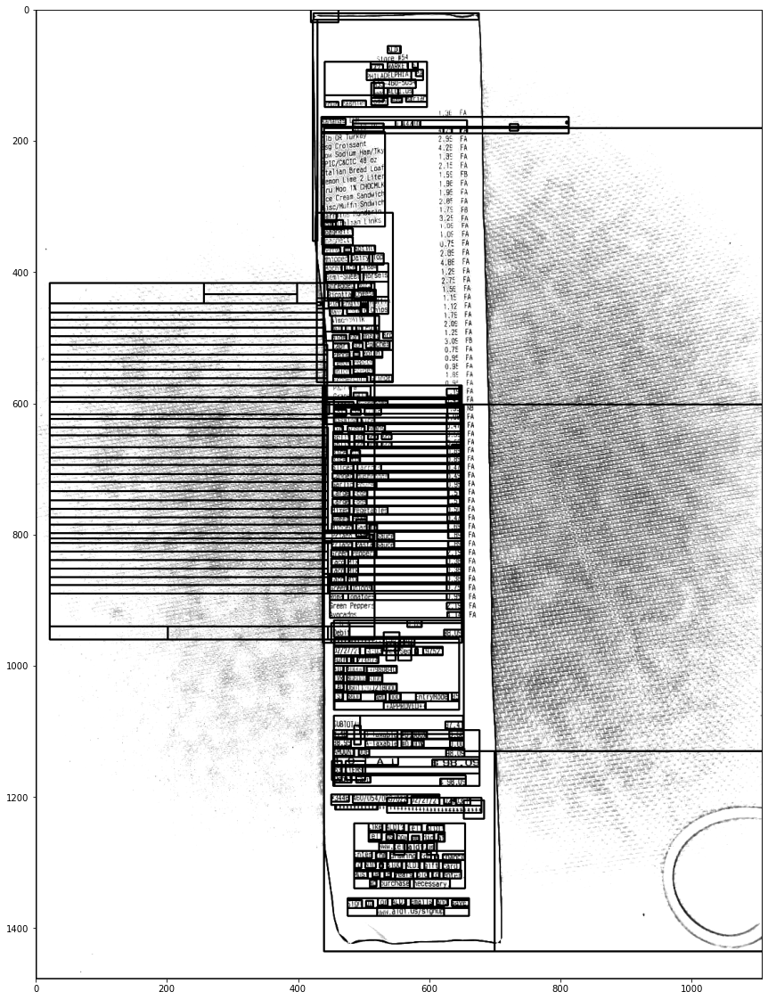

In [10]:
detect_texts_simple('sample_receipts/1958.jpg')

In [11]:
# approximate the contour by a more primitive polygon shape
def approximate_contour(contour, closed=True, tol=.05):
    peri = cv2.arcLength(contour, closed)
    return cv2.approxPolyDP(contour, tol * peri, closed)

In [46]:
def get_rect_from_approx_contour(contour):
    print(len(contour))
    if len(contour) == 4:
        return contour
    if len(contour) < 4:
        return None
    min_x, min_y, max_x, max_y = np.inf, np.inf, 0, 0
    for coord in contour:
        x, y = coord[0]
        min_x = min(x, min_x)
        min_y = min(y, min_y)
        max_x = max(x, max_x)
        max_y = max(y, max_y)
    return [[[min_x, min_y]], [[min_x, max_y]], [[max_x, min_y]], [[max_x, max_y]]]

In [100]:
def get_receipt_contour(contours, largest=False):    
    # loop over the contours
    if not largest:
        for c in contours:
            approx = approximate_contour(c)        
            # if our approximated contour has four points, we can assume it is receipt's rectangle
            print(len(approx))
            if len(approx) == 4:
                return approx
    else:
        new_contour = []
        for c in contours:
            for coord in c:
                new_contour.append(coord)
    #     print(len(contours))
    #     print(len(new_contour))
    #     approx = approximate_contour(new_contour)        
        approx = get_rect_from_approx_contour(new_contour)
        if len(approx) == 4:
            return approx

In [101]:
def contour_to_rect(contour):
    pts = contour.reshape(4, 2)
    rect = np.zeros((4, 2), dtype = "float32")
    # top-left point has the smallest sum
    # bottom-right has the largest sum
    s = pts.sum(axis = 1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    # compute the difference between the points:
    # the top-right will have the minumum difference 
    # the bottom-left will have the maximum difference
    diff = np.diff(pts, axis = 1)
    rect[1] = pts[np.argmin(diff)]
    rect[3] = pts[np.argmax(diff)]
    return rect

In [102]:
def wrap_perspective(img, rect):
    # unpack rectangle points: top left, top right, bottom right, bottom left
    (tl, tr, br, bl) = rect
    # compute the width of the new image
    widthA = np.sqrt(((br[0] - bl[0]) ** 2) + ((br[1] - bl[1]) ** 2))
    widthB = np.sqrt(((tr[0] - tl[0]) ** 2) + ((tr[1] - tl[1]) ** 2))
    # compute the height of the new image
    heightA = np.sqrt(((tr[0] - br[0]) ** 2) + ((tr[1] - br[1]) ** 2))
    heightB = np.sqrt(((tl[0] - bl[0]) ** 2) + ((tl[1] - bl[1]) ** 2))
    # take the maximum of the width and height values to reach
    # our final dimensions
    maxWidth = max(int(widthA), int(widthB))
    maxHeight = max(int(heightA), int(heightB))
    # destination points which will be used to map the screen to a "scanned" view
    dst = np.array([
        [0, 0],
        [maxWidth - 1, 0],
        [maxWidth - 1, maxHeight - 1],
        [0, maxHeight - 1]], dtype = "float32")
    # calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(rect, dst)
    # warp the perspective to grab the screen
    return cv2.warpPerspective(img, M, (maxWidth, maxHeight))

In [103]:
def get_warped_img_and_bg_img(img, bg_img, largest=False):
    fig, axs = plt.subplots(5, 1, figsize=(100, 100))
    
    edged = cv2.Canny(bg_img, 100, 200, apertureSize=3)
    
    contours, hierarchy = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    largest_contours = sorted(contours, key = lambda x: cv2.arcLength(x, closed=True), reverse = True)[:20]
    image_with_largest_contour = cv2.drawContours(img.copy(), [np.array(largest_contours[0])], -1, (0, 255, 0), 20)
    image_with_largest_contours = img.copy()
    for i in range(len(largest_contours)):
        image_with_largest_contours = cv2.drawContours(image_with_largest_contours, [np.array(largest_contours[i])], -1, (0, 255, 0), 20)
    image_with_all_contours = img.copy()
    for i in range(len(contours)):
        image_with_largest_contours = cv2.drawContours(image_with_all_contours, [np.array(contours[i])], -1, (0, 255, 0), 20)
    receipt_contour = np.array(get_receipt_contour(largest_contours, largest))
    image_with_receipt_contour = cv2.drawContours(img.copy(), [receipt_contour], -1, (0, 255, 0), 20)
    
    axs[0].imshow(edged,'gray')
    axs[0].set_title('edged')
    axs[1].imshow(image_with_largest_contour,'gray')
    axs[1].set_title('img with largest contour')
    axs[2].imshow(image_with_largest_contours,'gray')
    axs[2].set_title('img with largest contours')
    axs[3].imshow(image_with_all_contours,'gray')
    axs[3].set_title('img with all contours')
    axs[4].imshow(image_with_receipt_contour)
    axs[4].set_title('img with receipt')
    plt.show()
    if receipt_contour is None:
        print('Receipt not found')
        return None
    return wrap_perspective(img.copy(), contour_to_rect(receipt_contour)), wrap_perspective(bg_img.copy(), contour_to_rect(receipt_contour))

In [104]:
def get_warped_img_from_path(img_path, largest=False):
    img, bg_img = get_img_and_bg_img(img_path)
    fig, axs = plt.subplots(2, 1, figsize=(100, 100))
    axs[0].imshow(img, 'gray')
    axs[0].set_title('original img')
    axs[1].imshow(bg_img, 'gray')
    axs[1].set_title('background img')
    return get_warped_img_and_bg_img(img, bg_img, largest)

In [105]:
def detect_texts_wrap_from_img_path(img_path, largest=False):
    imgs = get_warped_img_from_path(img_path, largest)
    detect_texts_simple_with_bg_img_and_img(imgs[0], imgs[1])

- Remove margin
- Parallelogram

1229


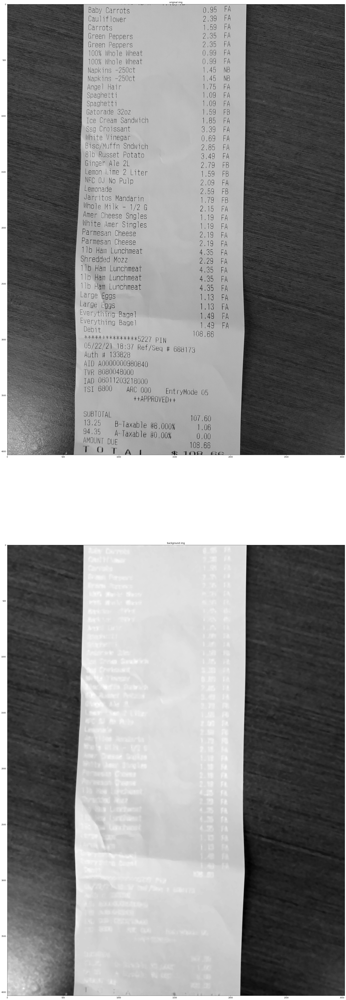

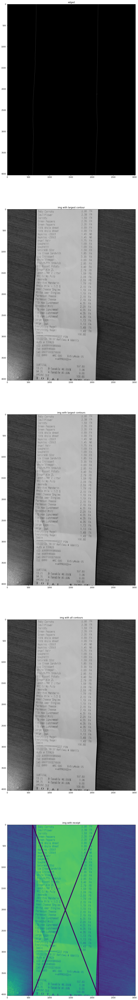

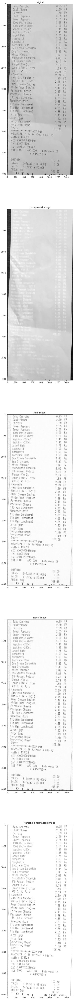

 

 

Baby Carrots 0.95
Cauliflower 2.39

| Carrots 1,99
Greer Peppers 2.39

| Green Peppers 2,39
100% Whole Wheat 0,99
100% Whole Wheat 0,99
Napkins -250ct 1.45
Napkins -250ct 1,45

| Angel Hair 1.75
Spaghetti 1.09

| Spaghetti 1.09
Gatorade 320z 1,59

| Ice Cream Sandwich 1.85
Ssg Croissant 3.39

| White Yinegar 0,69
Bisc/Muffa Sndwich 2.85
8]b Russet Potato 3,49
Ginger Ale 2L 2.19
Lemon |.ime 2 Liter 1,59

| NFC OJ No Pulp 2.09
Lemonade 2.59
Jarritos Mandarin 1.79

| Whole Wilk - 1/26 2.15
Amer Cheese Sngles 1.19
Hhite Amer Singles 1.19
Parmesan Cheese 2.19

| Parmesan Cheese 2.19
T1b Han Lunchmeat 4.35
Shredded Mozz 2.29

} 11b Ham Lunchmeat 4 35
1lb Ham Lunchmeat 4.35
11 Ham Lunchmeat 4.35
Large Eggs 1.13

| Large Eggs 1.13
Everything Bagel] 1.49
Everything Bagel 1.49
Debit 108.66

AARC AR RK doe 57 2t PIN

05/22/21 18:37 Ref/Seq # 688173
Auth # 133828

AID &0000000980840

TVR 8080048000

TAD 06011203218000

TSI 6800 ARC 000 ~—EntryMode 05

++APPROVED++
SUBTOTAL 107.60
13.25 B~lax

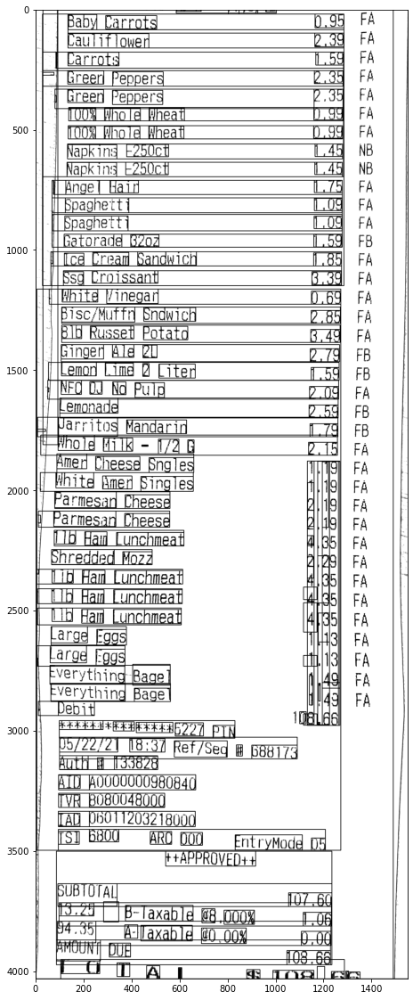

In [109]:
detect_texts_wrap_from_img_path('sample_receipts/5_22_02.jpg', largest=True)

4


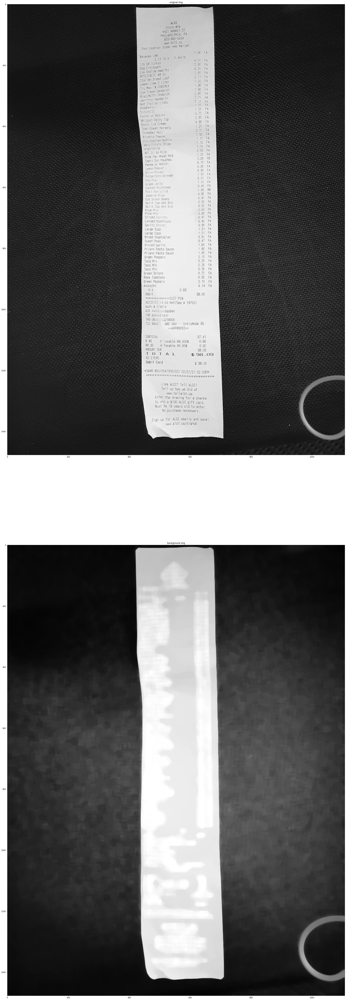

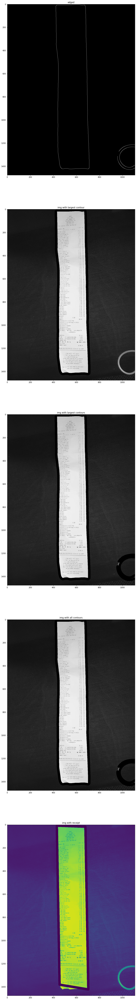

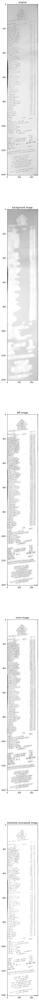

 

 

      

store #4
442) MARKET S|
PHILADELPHIA, PA
"g33-400-5054
fone ALDI US
Your casnier voany mis Hara”
aananas (RY nat A
Bg yp» waar
yoo urtey 4 FA
gag Croissant 2.36 FA
Sy sot Heed TAY a2 FA
petc/oselc 48 13 FA
tal ian 8°68 u Ze FA
dean vine 2: AEF ise 6B
Tru too. ‘ 1.96 FA
Tee cress S203 Woe Fa
peewee sie? 28 FA
darritos $370! ie 68
yt Traian a2 Fk
soaghett? V0 fA
a 0: FA
its FA
age fA
ae 1
ize fA
2

  

 

cut weer
split Top tnt Bro
Split. Tee tee Beh
ice "1
Rice m2
slices Carrots
Corned huenroate
Garlic Pouce”
Large Eso
Lerge E298
teed Yeoetao es
sweet Peas
winced bar 110
Priano Pasta Saxe
priano Pasta Sauce
Green Peooers
Taco Mix
aco Mi
Taco 4
Green onions
frona Tonatoes
Green Peopers
Avocados
6a 0.69
98.08

 

AID sane

Tag guts 1000

{aD 0601123218000,

Ts1 6800 ANC 000 entryHode $5
APPROVED

    

906/022 02/21/21 2:00

rrr Laas

 



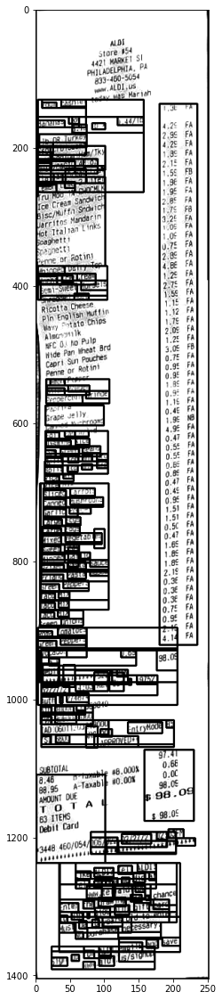

In [112]:
detect_texts_wrap_from_img_path('sample_receipts/1958.jpg', largest=False)

In [45]:
img = cv2.imread('sample_receipts/5_22_01.jpg',0)
approx_large = approximate_contour(largest_contours[0], tol=.032)
print(approx_large)
print(len(approx_large))
print(type(approx_large))
approx_rect = get_rect_from_approx_contour(approx_large)
print(approx_rect)
image_with_largest_contours = cv2.drawContours(img.copy(), np.array(approx_rect), -1, (0,255,0), 150)
plt.imshow(image_with_largest_contours,'gray')

NameError: name 'largest_contours' is not defined

In [159]:
get_rect_from_approx_contour(approx_large)

[[508 824]]
[[ 513 3662]]
[[501 832]]
[[2041  825]]
[[2021 4031]]
[[ 500 4031]]
[[2022 4030]]
[[2041  822]]


Assume that the largest contour includes the receipt

In [102]:
receipt_contour = get_receipt_contour(largest_contours)
image_with_receipt_contour = cv2.drawContours(img.copy(), [largest_contours], -1, (0, 255, 0), 2)
plt.imshow(image_with_receipt_contour)

8
2
1
2
8
2
1
2


error: OpenCV(4.5.2) :-1: error: (-5:Bad argument) in function 'drawContours'
> Overload resolution failed:
>  - contours is not a numpy array, neither a scalar
>  - Expected Ptr<cv::UMat> for argument 'contours'


In [ ]:
largest_contours

In [112]:
approx_large

array([[[ 508,  824]],

       [[ 513, 3662]],

       [[ 501,  832]],

       [[2041,  825]],

       [[2021, 4031]],

       [[ 500, 4031]],

       [[2022, 4030]],

       [[2041,  822]]], dtype=int32)

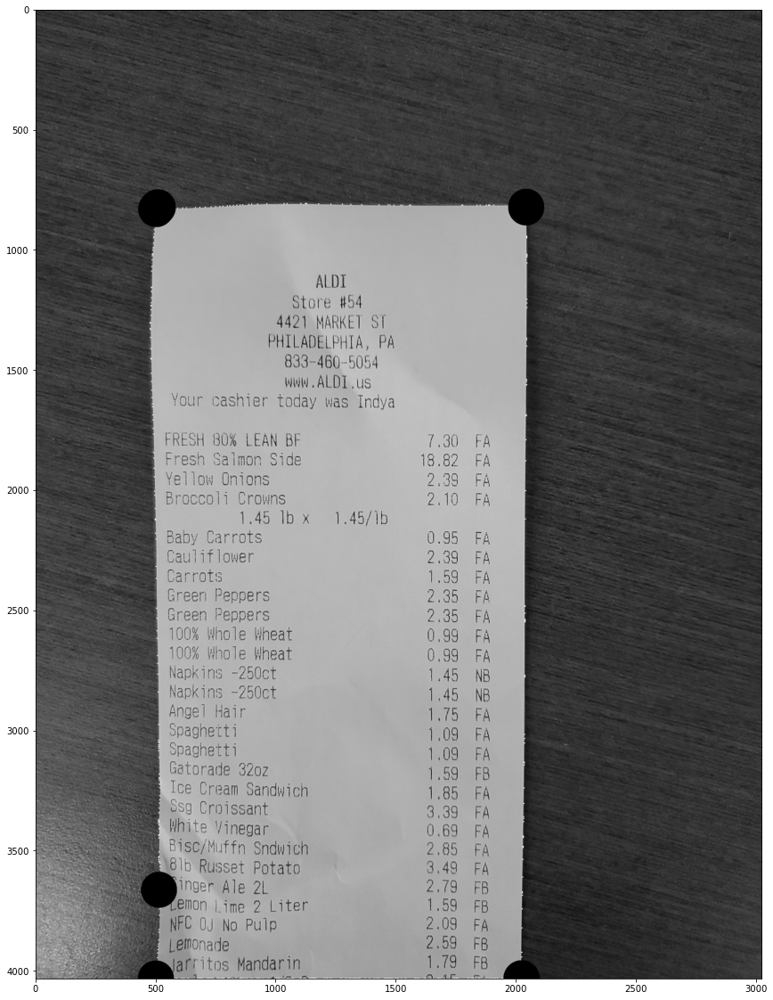

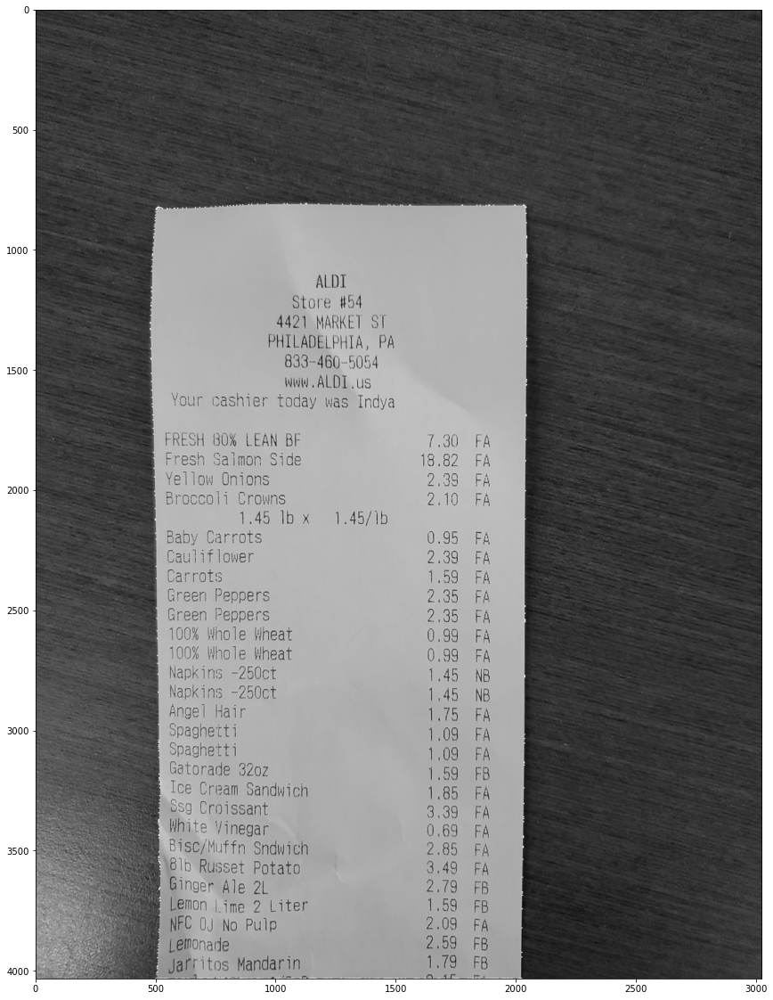

In [108]:
img = cv2.imread('sample_receipts/5_22_01.jpg',0)
dilated_img = cv2.dilate(img, np.ones((5,5), np.uint8)) 
bg_img = cv2.medianBlur(dilated_img, 21)
contours, hierarchy = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
largest_contours = sorted(contours, key = cv2.contourArea, reverse = True)[:10]
image_with_largest_contours = cv2.drawContours(img, largest_contours[0], -1, (255,255,255), 3)

# scanned = get_warped_img(img.copy(), bg_img.copy())

In [306]:
img = cv2.imread('sample_receipts/2.jpg',0)
img = adjust_gamma(img, .2)
ret,thresh1 = cv2.threshold(img,100,255,cv2.THRESH_BINARY)
thresh2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
            cv2.THRESH_BINARY,31,2)
thresh3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv2.THRESH_BINARY,31,2)